In [1]:
import numpy as np
import os
import sys
import pandas as pd
import seaborn as sns

import pylab as pl
import h5py

import tensorflow as tf
from tensorflow.keras import mixed_precision

os.environ['TF_CPP_MIN_LOG_LEVEL']='2'
os.environ['CUDA_VISIBLE_DEVICES']="0" 

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)


base_dir = '/media/tord/T7/Thesis_ssd/MasterThesis3'
os.chdir(base_dir)
from Classes.DataProcessing.LoadData import LoadData
from Classes.DataProcessing.HelperFunctions import HelperFunctions
from Classes.DataProcessing.DataHandler import DataHandler
from Classes.Modeling.DynamicModels import DynamicModels
from Classes.Modeling.TrainSingleModelRam import TrainSingleModelRam
from Classes.DataProcessing.RamLoader import RamLoader
import json

import gc
helper = HelperFunctions()

tf.config.optimizer.set_jit(True)
mixed_precision.set_global_policy('mixed_float16')

1 Physical GPUs, 1 Logical GPUs

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: GeForce RTX 3090, compute capability 8.6


In [2]:
load_args = {
    'earth_explo_only' : True,
    'noise_earth_only' : False,
    'noise_not_noise' : False,
    'downsample' : True,
    'upsample' : True,
    'frac_diff' : 1,
    'seed' : 1,
    'subsample_size' : 0.25,
    'balance_non_train_set' : False,
    'use_true_test_set' : False,
    'even_balance' : True
}
loadData = LoadData(**load_args)
train_ds, val_ds, test_ds = loadData.get_datasets()
noise_ds = loadData.noise_ds
handler = DataHandler(loadData)



2 2
Mapping train redundancy: : [--------------------------------------->] 100 %

Mapping validation redundancy: : [--------------------------------------->] 100 %

Mapping test redundancy: : [--------------------------------------->] 100 %



Loaded explosion and earthquake dataset:
Evenly balanced among classes in the train set.
Distribution (Label: (counts, proportion)) of
Train ds:
earthquake: (20507, 0.4987)  |  explosion: (20616, 0.5013)  
Val ds:
earthquake: (255, 0.0762)  |  explosion: (3092, 0.9238)  
Test ds:
earthquake: (176, 0.0789)  |  explosion: (2055, 0.9211)  


In [3]:
model_type = "InceptionTime"
is_lstm = True
num_channels = 3    

use_time_augmentor = True
scaler_name = "normalize"
use_noise_augmentor = True
filter_name = None
band_min = 2.0
band_max = 4.0
highpass_freq = 0.075


shutdown = False

num_classes = len(list(set(loadData.label_dict.values())))



ramLoader = RamLoader(loadData, 
                      handler, 
                      use_time_augmentor = use_time_augmentor, 
                      use_noise_augmentor = use_noise_augmentor, 
                      scaler_name = scaler_name,
                      filter_name = filter_name, 
                      band_min = band_min,
                      band_max = band_max,
                      highpass_freq = highpass_freq, 
                      load_test_set = True, 
                      meier_load = False)

x_train, y_train, x_val, y_val, x_test, y_test, noiseAug = ramLoader.load_to_ram()

Fitting noise set time augmentor: [--------------------------------------->] 100 %

Fit process completed after 9.591911792755127 seconds. Total datapoints fitted: 21199.
Average time per datapoint: 0.00045247001239469444




Fitting train time augmentor: [--------------------------------------->] 100 %

Fit process completed after 13.539043188095093 seconds. Total datapoints fitted: 41123.
Average time per datapoint: 0.00032923286696240773




Fitting validation time augmentor: [--------------------------------------->] 100 %

Fit process completed after 1.5757884979248047 seconds. Total datapoints fitted: 3347.
Average time per datapoint: 0.0004708062437779518




Fitting test time augmentor: [--------------------------------------->] 100 %

Fit process completed after 1.0353498458862305 seconds. Total datapoints fitted: 2231.
Average time per datapoint: 0.0004640743370175843




Stage one loading training set, timeAug: [--------------------------------------->] 100 %



Stage one loading validation set, timeAug: [--------------------------------------->] 100 %



Stage one loading test set, timeAug: [--------------------------------------->] 100 %

Fit process of normalizer skipped as unecessary




Stage one loading noise set, timeAug: [--------------------------------------->] 100 %



Stage two loading noise set, labels and normalize scaler: [--------------------------------------->] 100 %



Fitting noise augmentor: [--------------------------------------->] 100 %





Stage two loading training set, labels and normalize scaler: [--------------------------------------->] 100 %



Stage two loading validation set, labels and normalize scaler: [--------------------------------------->] 100 %



Stage two loading test set, labels and normalize scaler: [--------------------------------------->] 100 %



Completed loading to RAM
Time elapsed to completion of load_to_ram_earth_explo_only: 0:01:27.204215


['20210514-032749']
Trying to create result file
Made result file:  results_InceptionTime_earthExplo_timeAug_normalize_noiseAug_earlyS_unbalanced_valtest_subsample-0.25_numChannels-3_f2.csv
[   {'model_type': 'InceptionTime'},
    {   'batch_size': 64,
        'bottleneck_size': 32,
        'epochs': 50,
        'filter_size': 56,
        'l1_r': 0,
        'l2_r': 0,
        'learning_rate': 0.001,
        'meier_load': False,
        'module_activation': 'linear',
        'module_output_activation': 'relu',
        'num_filters': 64,
        'num_modules': 6,
        'optimizer': 'rmsprop',
        'output_layer_activation': 'sigmoid',
        'reg_module': False,
        'reg_residual': False,
        'residual_activation': 'relu',
        'use_bottleneck': False,
        'use_residuals': True}]
Saving file. 114 rows.
results_InceptionTime_earthExplo_timeAug_normalize_noiseAug_earlyS_unbalanced_valtest_subsample-0.25_numChannels-3_f2.csv saved to path:   /media/tord/T7/Thesis_ssd/Ma

642/642 [==============================] - 379s 562ms/step - loss: 0.5744 - precision: 0.7202 - recall: 0.7058 - binary_accuracy: 0.7051 - val_loss: 2.6862 - val_precision: 0.0777 - val_recall: 0.9968 - val_binary_accuracy: 0.0998
- val_f2: 0.2967
Epoch 2/50
642/642 [==============================] - 362s 564ms/step - loss: 0.4277 - precision: 0.7965 - recall: 0.8204 - binary_accuracy: 0.8025 - val_loss: 0.2957 - val_precision: 0.2485 - val_recall: 0.1941 - val_binary_accuracy: 0.8963
- val_f2: 0.2032
Epoch 3/50
642/642 [==============================] - 361s 563ms/step - loss: 0.4014 - precision: 0.8118 - recall: 0.8296 - binary_accuracy: 0.8168 - val_loss: 0.3609 - val_precision: 0.2789 - val_recall: 0.6769 - val_binary_accuracy: 0.8368
- val_f2: 0.5194
Epoch 4/50
642/642 [==============================] - 362s 563ms/step - loss: 0.3689 - precision: 0.8310 - recall: 0.8509 - binary_accuracy: 0.8362 - val_loss: 0.4638 - val_precision: 0.2394 - val_recall: 0.7919 - val_binary_accuracy:

642/642 [==============================] - 360s 560ms/step - loss: 9.1520e-05 - precision: 0.9999 - recall: 1.0000 - binary_accuracy: 1.0000 - val_loss: 0.7170 - val_precision: 0.3884 - val_recall: 0.7669 - val_binary_accuracy: 0.8852
- val_f2: 0.6221

Epoch 00031: ReduceLROnPlateau reducing learning rate to 5e-05.
Epoch 32/50
642/642 [==============================] - 359s 560ms/step - loss: 6.4669e-05 - precision: 1.0000 - recall: 1.0000 - binary_accuracy: 1.0000 - val_loss: 0.8879 - val_precision: 0.3468 - val_recall: 0.8101 - val_binary_accuracy: 0.8645
- val_f2: 0.6262
Restoring model weights from the end of the best epoch.
Epoch 00032: early stopping
52/52 [==============================] - 7s 136ms/step - loss: 0.5895 - precision: 0.4070 - recall: 0.7751 - binary_accuracy: 0.8954
2784 290 61 193
<tf.Tensor: shape=(2, 2), dtype=int32, numpy=
array([[2784,  290],
       [  61,  193]], dtype=int32)>
              precision    recall  f1-score   support

   explosion       0.98     

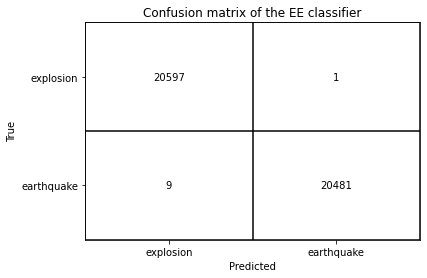

<tf.Tensor: shape=(2, 2), dtype=int32, numpy=
array([[20597,     1],
       [    9, 20481]], dtype=int32)>
              precision    recall  f1-score   support

   explosion       1.00      1.00      1.00     20598
  earthquake       1.00      1.00      1.00     20490

    accuracy                           1.00     41088
   macro avg       1.00      1.00      1.00     41088
weighted avg       1.00      1.00      1.00     41088

Unsaved val eval:
2786 288 61 193
['explosion', 'earthquake']
EE


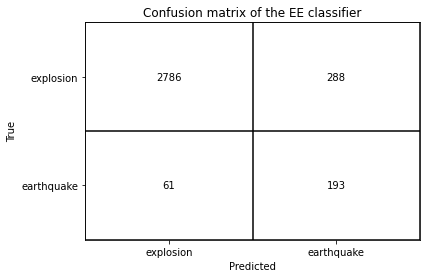

<tf.Tensor: shape=(2, 2), dtype=int32, numpy=
array([[2786,  288],
       [  61,  193]], dtype=int32)>
              precision    recall  f1-score   support

   explosion       0.98      0.91      0.94      3074
  earthquake       0.40      0.76      0.53       254

    accuracy                           0.90      3328
   macro avg       0.69      0.83      0.73      3328
weighted avg       0.93      0.90      0.91      3328

Unsaved test eval:
1829 180 39 128
['explosion', 'earthquake']
EE


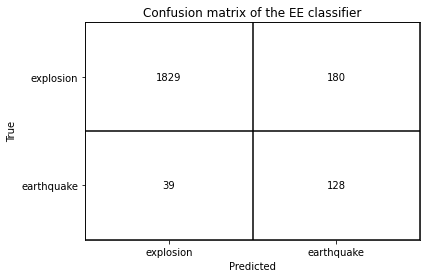

<tf.Tensor: shape=(2, 2), dtype=int32, numpy=
array([[1829,  180],
       [  39,  128]], dtype=int32)>
              precision    recall  f1-score   support

   explosion       0.98      0.91      0.94      2009
  earthquake       0.42      0.77      0.54       167

    accuracy                           0.90      2176
   macro avg       0.70      0.84      0.74      2176
weighted avg       0.94      0.90      0.91      2176



In [4]:
use_tensorboard = True
use_liveplots = False
use_custom_callback = True
use_early_stopping = True
start_from_scratch = False
use_reduced_lr = True
log_data = True

beta = 2

def clear_tensorboard_dir():
        import os
        import shutil
        path = f"{base_dir}/Tensorboard_dir/fit"
        files = os.listdir(path)
        print(files)
        for f in files:
            shutil.rmtree(os.path.join(path,f))
if use_tensorboard:
    clear_tensorboard_dir()

modelTrain = TrainSingleModelRam(noiseAug, helper,
                              loadData, model_type, num_channels, use_tensorboard, use_liveplots,
                              use_custom_callback, use_early_stopping, use_reduced_lr, ramLoader,
                              log_data = log_data, 
                              start_from_scratch = start_from_scratch, beta = beta)

params = {
    "meier_load" : False,
    "batch_size" : 64,
    "epochs" : 50,
    "learning_rate" : 0.001,
    "optimizer" : "rmsprop",
    "use_residuals" : True,
    "use_bottleneck" : False,
    "num_modules" : 6,
    "filter_size" : 56,
    "bottleneck_size" : 32,
    "num_filters" : 64,
    "residual_activation" : "relu",
    "module_activation" : "linear",
    "module_output_activation" : "relu",
    "output_layer_activation": "sigmoid",
    "reg_residual": False,
    "reg_module" : False,
    "l1_r" : 0,
    "l2_r" : 0
}
model = modelTrain.run(x_train, y_train, x_val, y_val, x_test, y_test, 16, 15, evaluate_train = True, evaluate_val = True, evaluate_test = True, meier_mode = False, **params)

2738 336 55 199


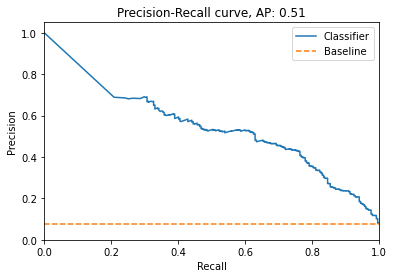

['explosion', 'earthquake']
EE


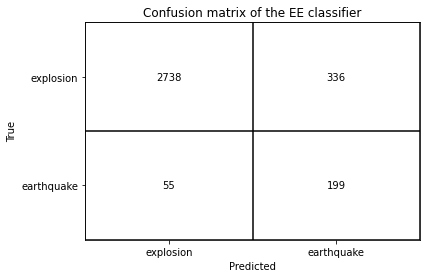

<tf.Tensor: shape=(2, 2), dtype=int32, numpy=
array([[2738,  336],
       [  55,  199]], dtype=int32)>
              precision    recall  f1-score   support

   explosion       0.98      0.89      0.93      3074
  earthquake       0.37      0.78      0.50       254

    accuracy                           0.88      3328
   macro avg       0.68      0.84      0.72      3328
weighted avg       0.93      0.88      0.90      3328



In [24]:
conf, report, accuracy, precision, recall, fscore = helper.evaluate_generator(model, x_val, y_val, params["batch_size"],
                                                                             loadData.label_dict, num_channels, noiseAug,
                                                                             scaler_name, 2, plot_conf_matrix = True, plot_p_r_curve = True, beta = beta)

In [25]:
accuracy, precision, recall, fscore

(0.88251201923076927,
 0.37196299999999999,
 0.78346499999999997,
 0.64152200000000004)

In [7]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 6000, 3)]    0                                            
__________________________________________________________________________________________________
max_pooling1d (MaxPooling1D)    (None, 6000, 3)      0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1d (Conv1D)                 (None, 6000, 64)     10752       input_1[0][0]                    
__________________________________________________________________________________________________
conv1d_1 (Conv1D)               (None, 6000, 64)     5376        input_1[0][0]                    
______________________________________________________________________________________________

In [21]:
save_dir = '/media/tord/T7/Thesis_ssd/SavedModels/InceptionTime'
model_name = 'IncpetionTime_EE_final'
model_path = f'{save_dir}/{model_name}'

#model.save(model_path)
model = helper.load_model(model_path)

In [22]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 6000, 3)]    0                                            
__________________________________________________________________________________________________
max_pooling1d (MaxPooling1D)    (None, 6000, 3)      0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1d (Conv1D)                 (None, 6000, 64)     10752       input_1[0][0]                    
__________________________________________________________________________________________________
conv1d_1 (Conv1D)               (None, 6000, 64)     5376        input_1[0][0]                    
______________________________________________________________________________________________

In [23]:
def get_false_negative_indexes(rounded_predictions, y_test):
    false_negative_indexes = []
    for i in range(len(rounded_predictions)):
        if y_test[i] == 1 and rounded_predictions[i] == 0:
            false_negative_indexes.append(i)
    return false_negative_indexes

def get_false_positive_indexes(rounded_predictions, y_test):
    false_positive_indexes = []
    for i in range(len(rounded_predictions)):
        if y_test[i] == 0 and rounded_predictions[i] == 1:
            false_positive_indexes.append(i)
    return false_positive_indexes

def get_true_positive_indexes(rouneded_predictions, y_test):
    true_positive_indexes = []
    for i in range(len(rounded_predictions)):
        if y_test[i] == 1 and rounded_predictions[i] == 1:
            true_positive_indexes.append(i)
    return true_positive_indexes

def get_true_negative_indexes(rouneded_predictions, y_test):
    true_negative_indexes = []
    for i in range(len(rounded_predictions)):
        if y_test[i] == 0 and rounded_predictions[i] == 0:
            true_negative_indexes.append(i)
    return true_negative_indexes

predictions = helper.predict_RamGenerator(model, x_val, y_val, params["batch_size"], True, noiseAug, loadData.label_dict, 3)
rounded_predictions = np.rint(predictions)
y = y_val


false_negatives_indexes = get_false_negative_indexes(rounded_predictions, y)
false_positives_indexes = get_false_positive_indexes(rounded_predictions, y)
true_negative_indexes = get_true_negative_indexes(rounded_predictions, y)
true_positive_indexes = get_true_positive_indexes(rounded_predictions, y)

# True Positive

In [11]:
import pprint
i = 0
pp = pprint.PrettyPrinter(indent = 4)

Predicted label: [ 1.], Correct: [1]
Transformed


/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/util.py:275: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small')
/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/waveform.py:820: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small',


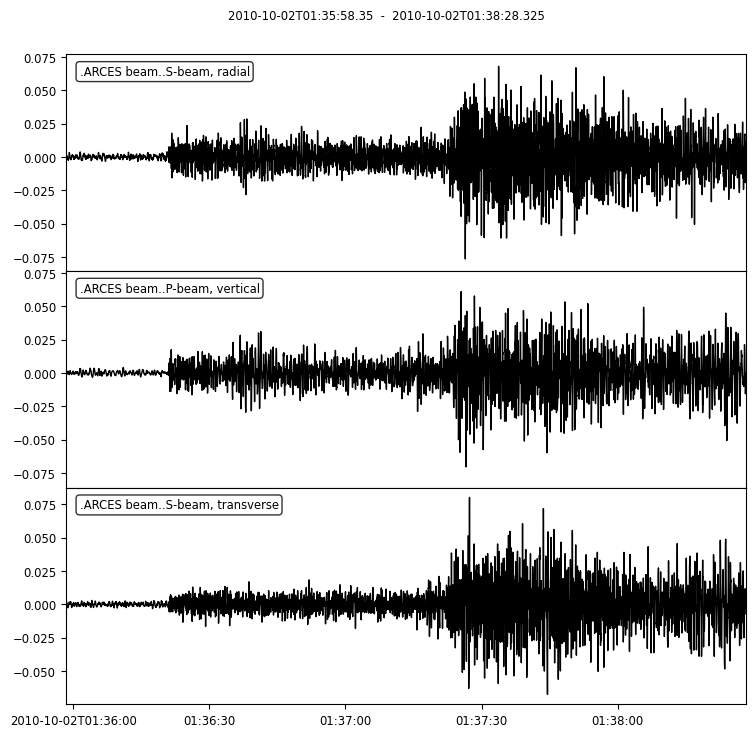

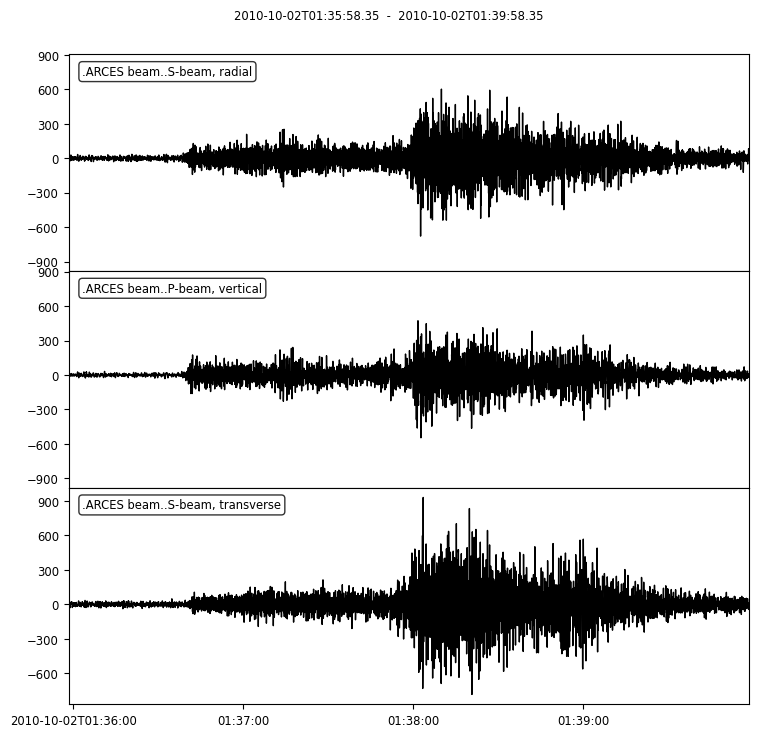

{   'analyst_pick_time': None,
    'az_to_arces': 162.11028823239158,
    'baz_to_arces': 348.5501326700314,
    'dist_to_arces': 853.5922704788013,
    'est_arrivaltime_arces': '2010-10-02 01:36:58.340000',
    'event_type': 'earthquake',
    'event_type_certainty': 'known',
    'magnitude_dist_ratio': 0.0037043446963576122,
    'magnitude_sqrtdist_ratio': 0.10822725132739336,
    'magnitudes': [   {   'mag': 3.162,
                          'magnitude_type': 'Mb',
                          'origin_id': 'smi:local/0c393f40-54e0-47fe-8f78-b31635a00271',
                          'resource_id': 'smi:local/4c1f4342-fe33-455d-be3f-9cc09673ce18'},
                      {   'mag': 3.2,
                          'magnitude_type': 'Ml',
                          'origin_id': 'smi:local/0c393f40-54e0-47fe-8f78-b31635a00271',
                          'resource_id': 'smi:local/9e7afb3c-ba7e-4926-857f-0ee862501626'}],
    'origins': [   {   'arrivals': [   {   'azimuth': 289.90144,
             

In [12]:
index = true_positive_indexes[i]
original_trace, sample_info = handler.path_to_trace(val_ds[index][0])
transformed_trace = x_val[index]
print(f"Predicted label: {predictions[index]}, Correct: {y_val[index]}")
print("Transformed")
helper.plot_event(transformed_trace, sample_info)
helper.plot_event(original_trace, sample_info)
pp = pprint.PrettyPrinter(indent=4)
pp.pprint(sample_info)
i += 1

# False Positive

In [13]:
j = 0

Predicted label: [ 0.999039], Correct: [0]
Transformed
11


/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/util.py:275: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small')
/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/waveform.py:820: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small',


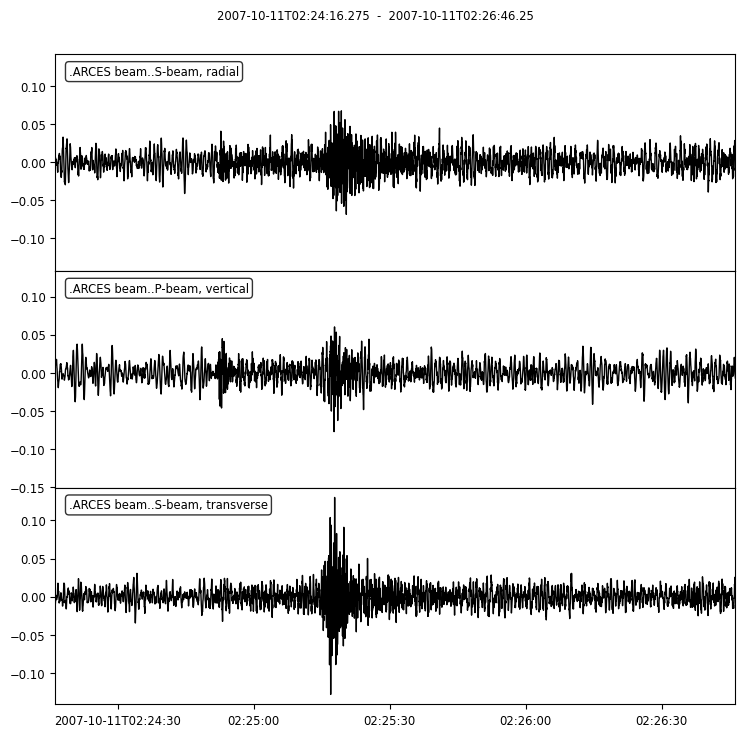

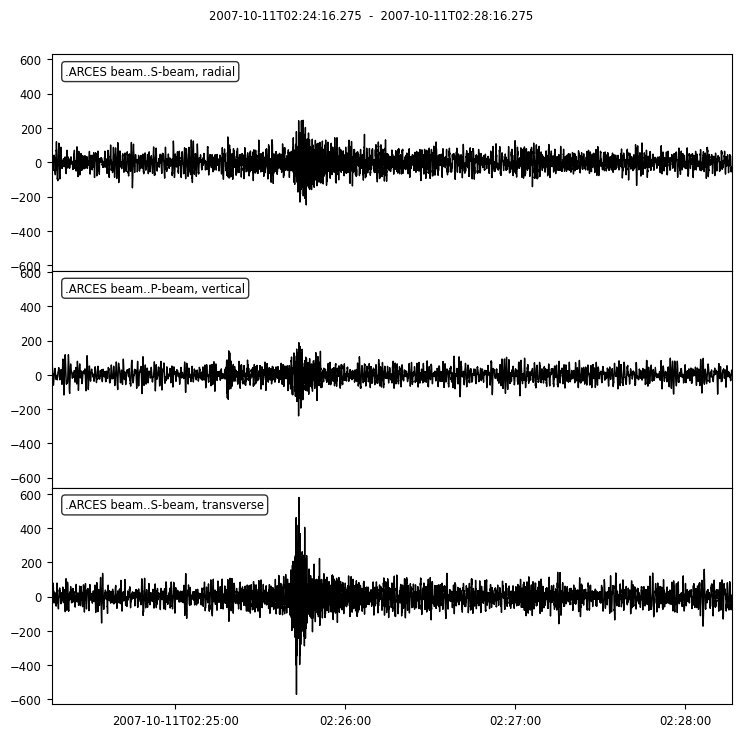

{   'analyst_pick_time': None,
    'az_to_arces': 276.3848141109405,
    'baz_to_arces': 91.42390903085781,
    'dist_to_arces': 207.85341365369766,
    'est_arrivaltime_arces': '2007-10-11 02:25:16.277000',
    'event_type': 'explosion',
    'event_type_certainty': 'known',
    'magnitude_dist_ratio': 0.0062544077441321995,
    'magnitude_sqrtdist_ratio': 0.09017056097957836,
    'magnitudes': [   {   'creation_info': {'agency_id': 'HEL'},
                          'mag': 1.3,
                          'mag_errors': {'uncertainty': 0.1},
                          'magnitude_type': 'ML',
                          'origin_id': 'smi:local/ad6ee41b-1094-4720-95b8-9d7c5e8be9b2',
                          'resource_id': 'smi:local/8efbcbed-3b8a-49fe-bef5-10287348ae37',
                          'station_count': 5}],
    'origins': [   {   'creation_info': {'agency_id': 'HEL'},
                       'depth': 0.0,
                       'latitude': 69.403,
                       'latitude_er

In [44]:
# Plotting false negative
index = false_positives_indexes[j]
original_trace, sample_info = handler.path_to_trace(val_ds[index][0])
transformed_trace = x_val[index]
print(f"Predicted label: {predictions[index]}, Correct: {y_val[index]}")
print("Transformed")
print(j)
helper.plot_event(transformed_trace, sample_info)
helper.plot_event(original_trace, sample_info)
pp = pprint.PrettyPrinter(indent=4)
pp.pprint(sample_info)
j += 1

# True Negative

In [15]:
k = 0

Predicted label: [ 0.37439147], Correct: [0]
Transformed


/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/util.py:275: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small')
/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/waveform.py:820: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small',


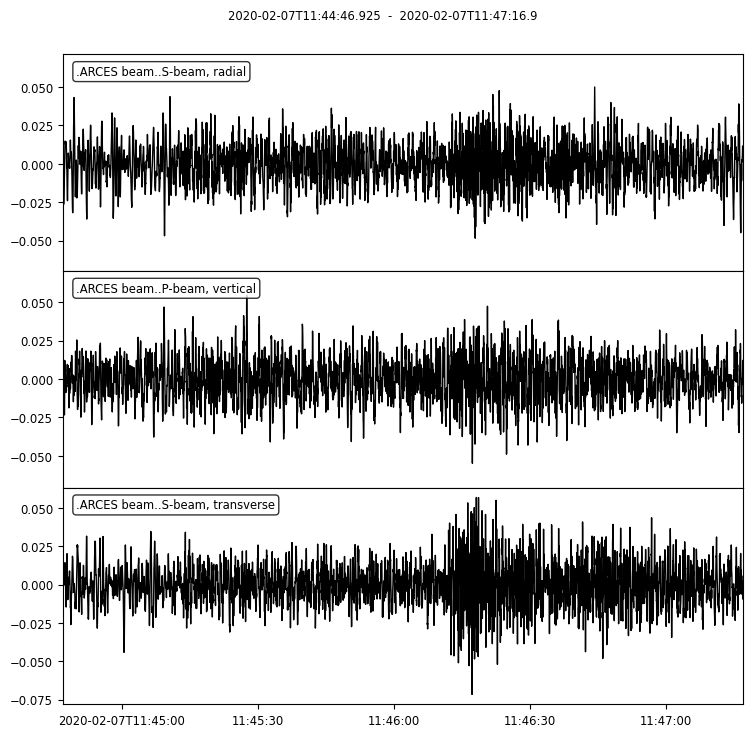

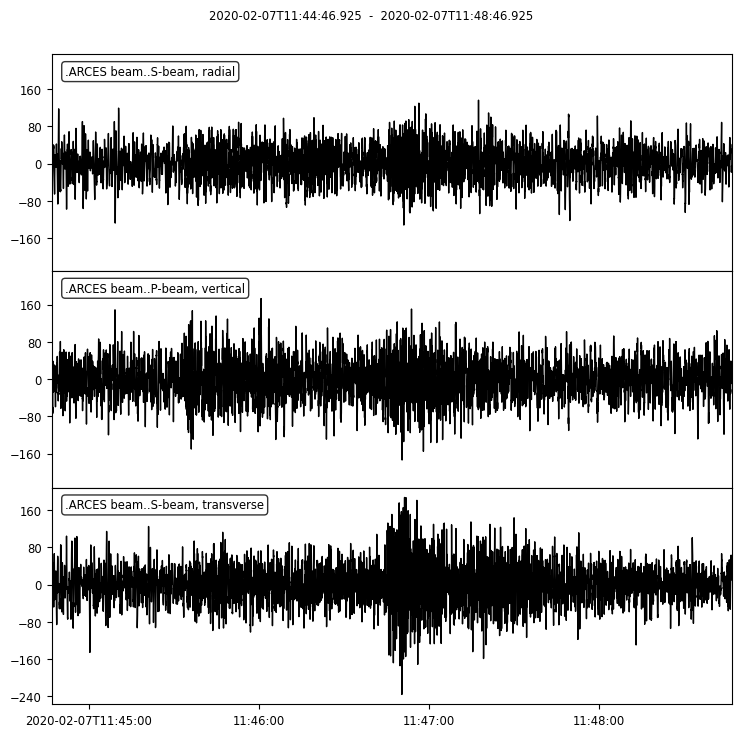

{   'analyst_pick_time': None,
    'az_to_arces': 352.8996380128055,
    'baz_to_arces': 170.81536819331515,
    'comments': [   {   'creation_info': {'author': 'general'},
                        'resource_id': 'smi:local/60dcd277-c42a-41a9-ac7f-c9d85588107b',
                        'text': 'FULLY AUTOMATIC, EVENT TYPE & LOCATION & '
                                'MAGNITUDE CHECKED (TUL)'},
                    {   'creation_info': {'author': 'mining area'},
                        'resource_id': 'smi:local/6daf09a0-548e-44db-a630-073b7ed7e43a',
                        'text': 'MINING AREA: SIILINJARVI  4KM'}],
    'dist_to_arces': 719.0056720309096,
    'est_arrivaltime_arces': '2020-02-07 11:45:46.916000',
    'event_type': 'explosion',
    'event_type_certainty': 'known',
    'magnitude_dist_ratio': 0.002642538263478845,
    'magnitude_sqrtdist_ratio': 0.07085776386966926,
    'magnitudes': [   {   'creation_info': {'agency_id': 'HEL'},
                          'mag': 1.9,
     

In [16]:
# Plotting true negative
index = true_negative_indexes[k]
original_trace, sample_info = handler.path_to_trace(val_ds[index][0])
transformed_trace = x_val[index]
print(f"Predicted label: {predictions[index]}, Correct: {y_val[index]}")
print("Transformed")
helper.plot_event(transformed_trace, sample_info)
helper.plot_event(original_trace, sample_info)
pp = pprint.PrettyPrinter(indent=4)
pp.pprint(sample_info)
k += 1

# False Negative

In [17]:
m = 0

Predicted label: [  2.69693264e-05], Correct: [1]
Transformed
10


/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/util.py:275: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small')
/home/tord/miniconda3/envs/thesis/lib/python3.8/site-packages/obspy/imaging/waveform.py:820: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 30.
  plt.setp(ax.get_xticklabels(), fontsize='small',


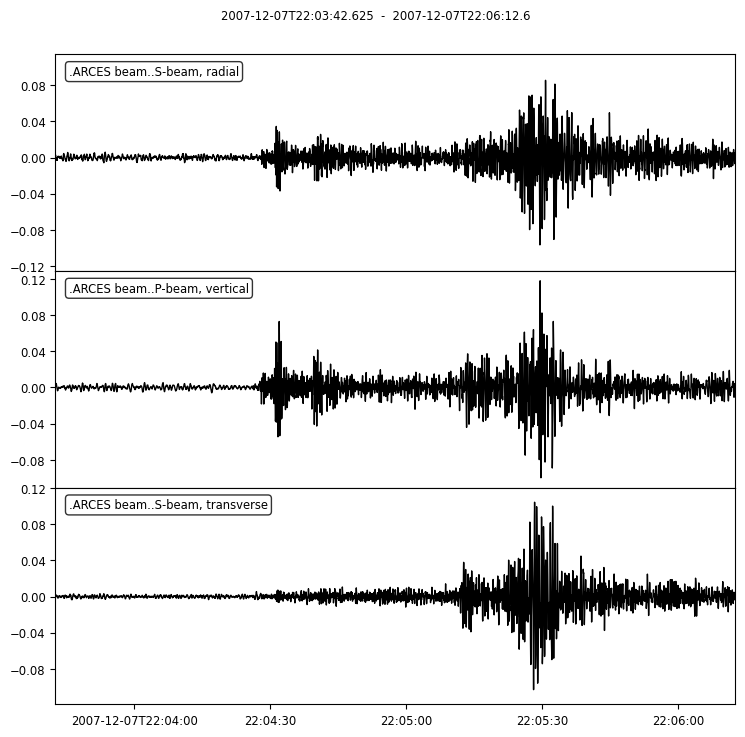

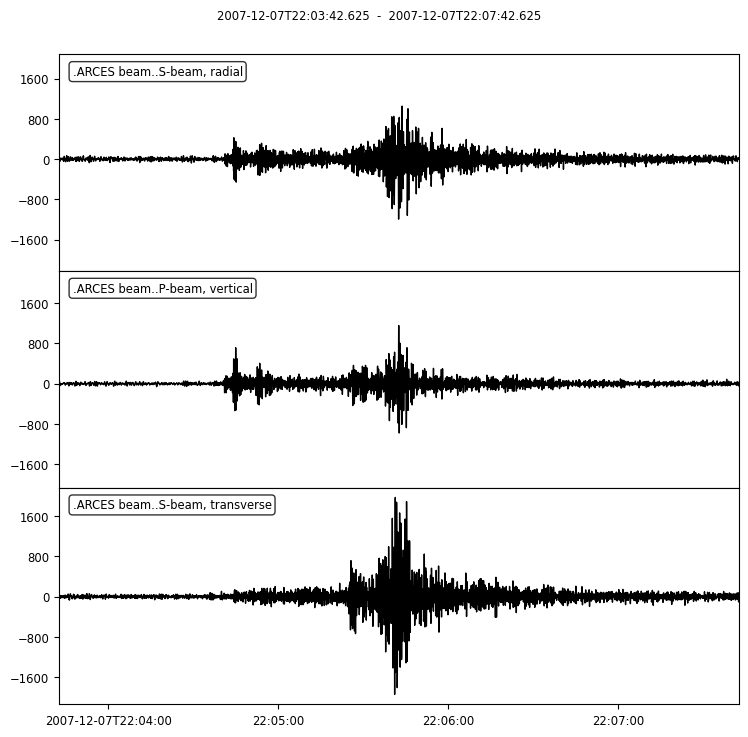

{   'analyst_pick_time': None,
    'az_to_arces': 305.07842965579977,
    'baz_to_arces': 116.6087920898662,
    'dist_to_arces': 432.5393167877437,
    'est_arrivaltime_arces': '2007-12-07 22:04:42.634000',
    'event_type': 'earthquake',
    'event_type_certainty': 'known',
    'magnitude_dist_ratio': 0.006128922613758375,
    'magnitude_sqrtdist_ratio': 0.12746675585843334,
    'magnitudes': [   {   'mag': 2.651,
                          'magnitude_type': 'Mb',
                          'origin_id': 'smi:local/ffe48240-e02d-4af7-8dc6-f0e53b5e3dbb',
                          'resource_id': 'smi:local/379dd13a-fe75-4060-b725-b1bf43b5b7e4'},
                      {   'mag': 2.51,
                          'magnitude_type': 'Ml',
                          'origin_id': 'smi:local/ffe48240-e02d-4af7-8dc6-f0e53b5e3dbb',
                          'resource_id': 'smi:local/c9210144-cbc5-4568-bf47-cbc5a689f2ad'}],
    'origins': [   {   'arrivals': [   {   'azimuth': 27.328783,
             

In [54]:
# Plotting false negative
index = false_negatives_indexes[m]
original_trace, sample_info = handler.path_to_trace(val_ds[index][0])
transformed_trace = x_val[index]
print(f"Predicted label: {predictions[index]}, Correct: {y_val[index]}")
print("Transformed")
print(m)
helper.plot_event(transformed_trace, sample_info)
helper.plot_event(original_trace, sample_info)
pp = pprint.PrettyPrinter(indent=4)
pp.pprint(sample_info)
m += 1